# Preliminaries

Import Libraries

In [1]:
import pandas as pd
from datasets import load_dataset

import sentencepiece as spm

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, TensorDataset
from torch.nn.utils.rnn import pad_sequence
from torch.nn.functional import cosine_similarity

from tqdm import tqdm 

import random
import os

/home/eli/miniconda3/envs/search/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Set the device

In [2]:
if torch.cuda.is_available():
    print("CUDA is available. GPU can be used.")
else:
    print("CUDA is not available. Running on CPU.")

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

CUDA is available. GPU can be used.


Set the hyperparameters

In [3]:
# Hyperparameters
vocab_size = 16000  # Number of tokens in the vocabulary
embedding_dim = 128  # The dimension of the word embeddings
window_size = 2  # The context size
encoding_dim = 512
batch_size = 32
margin = 1
learning_rate = 0.1
cbow_epochs = 200
epochs = 10

# Importing and processing the data

Import the dataset

In [4]:
dataset = load_dataset("ms_marco", "v1.1")

Split into train, val, test

In [5]:
val_data = dataset["validation"]
val_df = pd.DataFrame(val_data)

train_data = dataset["train"]
train_df = pd.DataFrame(train_data)

test_data = dataset["test"]
test_df = pd.DataFrame(test_data)

Method for extracting queries, lists of relevant documents for each query, and the set of all unique documents

In [6]:
def df_to_lists(df):
    queries = df['query'].tolist()
    lists_of_documents = df['passages'].tolist()
    all_documents = []
    for document_list in lists_of_documents:
        for document in document_list["passage_text"]:
            all_documents.append(document)
    unique_documents = list(set(all_documents))
    return queries, lists_of_documents, unique_documents

Create the text corpus

In [7]:
# Making a text corpus
train_queries, train_lists_of_documents, train_unique_documents  = df_to_lists(train_df)
val_queries, val_lists_of_documents, val_unique_documents  = df_to_lists(val_df)
test_queries, test_lists_of_documents, test_unique_documents  = df_to_lists(test_df)

# with open('corpus.txt', 'w') as file:
#     for query in train_queries:
#         file.write(f'{query}\n')
#     for document_list in train_lists_of_documents:
#         for document in document_list["passage_text"]:
#             file.write(f'{document}\n')
        
#     for query in val_queries:
#         file.write(f'{query}\n')
#     for document_list in val_lists_of_documents:
#         for document in document_list["passage_text"]:
#             file.write(f'{document}\n')
            
#     for query in test_queries:
#         file.write(f'{query}\n')
#     for document_list in test_lists_of_documents:
#         for document in document_list["passage_text"]:
#             file.write(f'{document}\n')

Train SentencePiece on the test corpus to produce a tokenizer

In [13]:
# Train SentencePiece model
# spm.SentencePieceTrainer.train(input="corpus.txt", model_prefix="search_engine", vocab_size=vocab_size)

Method for tokenizing and generating the labelled input data: triples of (query, relevant document, irrelevant document)

In [8]:
def generate_labelled_dataset(df, tokenizer_model):
    queries, lists_of_documents, unique_documents = df_to_lists(df)
    
    tokenized_queries = []
    tokenized_positive_documents = []
    tokenized_negative_documents = []
    
    sp = spm.SentencePieceProcessor()
    sp.load(tokenizer_model)

    counter = 0
    for document_list in lists_of_documents:
        for document in document_list["passage_text"]:
            
            tokenized_queries.append(sp.EncodeAsIds(queries[counter]))
            
            tokenized_positive_documents.append(sp.EncodeAsIds(document))
            
            # Randomly select an irrelevant (negative) document by *negative sampling* 
            random_integer = random.randint(0, len(unique_documents)-1)
            tokenized_negative_documents.append(sp.EncodeAsIds(unique_documents[random_integer]))
        
        counter+= 1
        
    return tokenized_queries, tokenized_positive_documents, tokenized_negative_documents

Process our dataset to product our labelled input data

In [ ]:
train_tokenized_queries, train_tokenized_positive_documents, train_tokenized_negative_documents = generate_labelled_dataset(train_df, "search_engine.model")

val_tokenized_queries, val_tokenized_positive_documents, val_tokenized_negative_documents  = generate_labelled_dataset(val_df, "search_engine.model")

test_tokenized_queries, test_tokenized_positive_documents, test_tokenized_negative_documents  = generate_labelled_dataset(test_df, "search_engine.model")

Create Dataset class for Dataloader later

In [28]:
class TokenIdDataset(Dataset):
    def __init__(self, tokenized_queries, tokenized_positive_documents, tokenized_negative_documents):
        self.tokenized_queries = [torch.tensor(query) for query in tokenized_queries]
        self.tokenized_positive_documents = [torch.tensor(positive_document) for positive_document in tokenized_positive_documents]
        self.tokenized_negative_documents = [torch.tensor(negative_document) for negative_document in tokenized_negative_documents]
    def __len__(self):
        return len(self.tokenized_queries)
    
    def __getitem__(self, index):
        return self.tokenized_queries[index], self.tokenized_positive_documents[index], self.tokenized_negative_documents[index]

Create Collate Function for Dataloader later 

In [17]:
# A function for padding to the left
def pad_left(data, batch_first=True, padding_value=0):
    right_data = pad_sequence(data, batch_first, padding_value)
    left_data = torch.zeros_like(right_data)
    for i, datum in enumerate(data):
        left_data[i, -len(data[i]):] = datum
    return left_data

# A custom collate function to pad the sequences to the maximum length found in the batch for each of the three lists.
def pad_collate(batch):
    data1, data2, data3 = zip(*batch)
    data1_padded = pad_left(data1, batch_first=True, padding_value=0)
    data2_padded = pad_left(data2, batch_first=True, padding_value=0)
    data3_padded = pad_left(data3, batch_first=True, padding_value=0)
    return data1_padded, data2_padded, data3_padded

Create datasets and dataloaders for batching our data

In [18]:
# Create DataLoaders for training, validation, and test sets
train_dataset = TokenIdDataset(train_tokenized_queries, train_tokenized_positive_documents, train_tokenized_negative_documents)
train_data_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, collate_fn=pad_collate)

val_dataset = TokenIdDataset(val_tokenized_queries, val_tokenized_positive_documents, val_tokenized_negative_documents)
val_data_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=True, collate_fn=pad_collate)

test_dataset = TokenIdDataset(test_tokenized_queries, test_tokenized_positive_documents, test_tokenized_negative_documents)
test_data_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=True, collate_fn=pad_collate)

Tokenize queries to use in our word2vec embedding model

In [19]:
queries = train_queries + val_queries + test_queries

sp = spm.SentencePieceProcessor()
sp.load("search_engine.model")

tokenized_queries = [sp.encode_as_ids(query) for query in queries]

## Building the Word2Vec Embedding

### CBOW

In [8]:
# Generate all the pairs of tokens and context windows for CBOW
def generate_cbow_pairs(tokenized_sentences, window_size=2):
    cbow_pairs = []
    for sentence in tokenized_sentences:
        sentence_length = len(sentence)
        for index, word in enumerate(sentence):
            start = index - window_size
            end = index + window_size + 1
            
            context = [sentence[i] for i in range(start, end) if 0 <= i < sentence_length and i != index]
            target = word
            cbow_pairs.append((context, target))
    return cbow_pairs

In [9]:
# A `Dataset` class for generating pairs of tokens and context windows for CBOW one at a time, to use in the `DataLoader` to generate mini-batches
class CBOWDataset(Dataset):
    def __init__(self, cbow_pairs, context_size):
        self.cbow_pairs = cbow_pairs
        self.context_size = context_size

    def __len__(self):
        return len(self.cbow_pairs)

    def __getitem__(self, idx):
        context, target = self.cbow_pairs[idx]
        # Pad or trim the context to ensure uniform size
        if len(context) < 2 * self.context_size:
            context += [0] * (2 * self.context_size - len(context))  # Assuming 0 is the padding index
        else:
            context = context[:2 * self.context_size]
        return torch.tensor(context, dtype=torch.long), torch.tensor(target, dtype=torch.long)

In [10]:
# The CBOW model, which is just an embedding layer, an average pooling, and a final output linear layer followed by a softmax activation
class CBOWModel(nn.Module):
    def __init__(self, vocab_size, embedding_dim):
        super(CBOWModel, self).__init__()
        self.embeddings = nn.Embedding(vocab_size, embedding_dim)
        self.linear = nn.Linear(embedding_dim, vocab_size)

    def forward(self, context_words):
        embedded = self.embeddings(context_words)
        projection = torch.mean(embedded, dim=1)
        out = self.linear(projection)
        log_probs = nn.functional.log_softmax(out, dim=1)
        return log_probs
    
    def embed(self, word):
        self.eval()
        embedding = self.embeddings(word)
        return embedding

In [23]:
# # Applying the data generating functions we wrote earlier to our data
# cbow_pairs = generate_cbow_pairs(tokenized_queries, window_size)
# cbow_dataset = CBOWDataset(cbow_pairs, window_size)
# cbow_dataloader = DataLoader(cbow_dataset, batch_size=batch_size, shuffle=True)

In [24]:
# # Model, loss, and optimizer
# cbow_model = CBOWModel(vocab_size, embedding_dim)  # Assuming CBOWModel is defined as before
# cbow_model = cbow_model.to(device)
# cbow_loss_function = nn.NLLLoss()
# cbow_optimizer = optim.SGD(cbow_model.parameters(), lr=learning_rate)

# # Training loop
# for epoch in range(cbow_epochs):
#     total_loss = 0
#     with tqdm(cbow_dataloader, unit="batch") as tepoch:
#         for context, target in tepoch:
#             context, target = context.to(device), target.to(device)
#             tepoch.set_description(f"Epoch {epoch+1}")
            
#             cbow_model.zero_grad()
#             log_probs = cbow_model(context)
#             loss = cbow_loss_function(log_probs, target)
#             loss.backward()
#             cbow_optimizer.step()

#             total_loss += loss.item()
#             tepoch.set_postfix(loss=loss.item())

#     print(f"Epoch {epoch+1} finished with total loss: {total_loss:.4f}")
#     torch.save(cbow_model.state_dict(), os.path.join("cbow_weights", f"cbow_epoch_{epoch+1}.pth"))

# Building the Two Tower Model 

Two Tower Architecture: one RNN for encoding queries and another RNN for encoding queries

In [11]:
class Two_Towers(nn.Module):
    def __init__(self, embedding_dim, encoding_dim):
        super(Two_Towers, self).__init__()
        self.query_encoding = nn.RNN(embedding_dim, encoding_dim, num_layers=1, bias=True, batch_first=True, bidirectional=False)        
        self.document_encoding = nn.RNN(embedding_dim, encoding_dim, num_layers=1, bias=True, batch_first=True, bidirectional=False)

    def encode_query(self, query_embeddings):
        _, query_encoding     = self.query_encoding(query_embeddings) # The input should have shape (num_examples, max_query_length, embedding_dim) and the final hidden state should have shape (2, num_examples, encoding_dim) 
        return query_encoding

    def encode_document(self, document_embeddings):
        _, document_encoding  = self.document_encoding(document_embeddings) # The input should have shape (num_examples, max_document_length, embedding_dim) and the final hidden state should have shape (2, num_examples, encoding_dim) 
        return document_encoding

    def forward(self, query_embeddings, positive_document_embeddings, negative_document_embeddings):
        _, query_encoding = self.query_encoding(query_embeddings)
        _, positive_document_encoding = self.document_encoding(positive_document_embeddings)
        _, negative_document_encoding = self.document_encoding(negative_document_embeddings)
        return query_encoding, positive_document_encoding, negative_document_encoding

The overall Search Engine model: produces token embeddings and then encodings for queries, relevant documents and irrelevant documents

In [12]:
class Search_Engine(nn.Module):
    def __init__(self, vocab_size, embedding_dim, encoding_dim, embedding_model, embedding_weights):
        super(Search_Engine, self).__init__()
        self.token_embedding = embedding_model(vocab_size, embedding_dim)
        self.token_embedding.load_state_dict(torch.load(embedding_weights))
        self.token_embedding.eval()

        self.two_towers = Two_Towers(embedding_dim, encoding_dim)
    
    def forward(self, tokenized_queries, tokenized_positive_documents, tokenized_negative_documents):
        self.token_embedding.eval()
        query_embeddings = self.token_embedding.embed(tokenized_queries) 
        positive_document_embeddings = self.token_embedding.embed(tokenized_positive_documents)
        negative_document_embeddings = self.token_embedding.embed(tokenized_negative_documents)
        query_encoding, positive_document_encoding, negative_document_encoding = self.two_towers(query_embeddings, positive_document_embeddings, negative_document_embeddings)
        return query_encoding, positive_document_encoding, negative_document_encoding
    
    def encode_query(self, tokenized_queries):
        self.token_embedding.eval()
        query_embeddings = self.token_embedding.embed(tokenized_queries) 
        query_encoding = self.two_towers.encode_query(query_embeddings)
        return query_encoding

    def encode_document(self, tokenized_documents):
        self.token_embedding.eval()
        document_embeddings = self.token_embedding.embed(tokenized_documents)
        document_encoding = self.two_towers.encode_document(document_embeddings)
        return document_encoding

# Training and Testing

Define the cosine distance

In [13]:
def cosine_distance(x, y):
    return 1 - cosine_similarity(x, y, dim=-1)

Method for using the cosine similarity with a threshold to predict relevant and irrelevant documents 

In [14]:
def threshold_similarity(batch1, batch2):
    # Compute cosine similarity between batch1 and batch2
    similarity = cosine_similarity(batch1, batch2, dim=-1)

    # Set similarity to 1 (relevant) if positive, 0 (irrelevant) if negative
    threshold_similarity = torch.where(similarity > 0, torch.tensor(1), torch.tensor(0))

    return threshold_similarity

In [30]:
torch.save(model.state_dict(), os.path.join("search_engine_weights", f"sp_search_engine_epoch_{epoch+1}.pth"))

Training loop

In [34]:
# Instantiate our model
model = Search_Engine(vocab_size, embedding_dim, encoding_dim, CBOWModel, "cbow_weights/cbow_epoch_127.pth")
model = model.to(device)
model.load_state_dict(torch.load(f"search_engine_weights/sp_search_engine_epoch_1.pth"))

# Define loss function and optimizer
criterion = nn.TripletMarginWithDistanceLoss(distance_function=cosine_distance, margin=margin)
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

# Training and validation loop
for epoch in range(9):
    # Training
    model.train()
    train_loss = 0
    for train_queries, train_positive_documents, train_negative_documents in tqdm(train_data_loader, desc=f"Train Epoch {epoch+1}"):
        train_queries, train_positive_documents, train_negative_documents = train_queries.to(device), train_positive_documents.to(device), train_negative_documents.to(device)
        
        optimizer.zero_grad()
        
        train_query_encodings, train_positive_document_encodings, train_negative_document_encodings = model(train_queries, train_positive_documents, train_negative_documents)

        loss = criterion(train_query_encodings, train_positive_document_encodings, train_negative_document_encodings)
        loss.backward() 

        optimizer.step()
        
        train_loss += loss.item()

    train_loss /= len(train_data_loader)

    # Validation
    model.eval()
    with torch.no_grad():
        val_loss = 0
        val_accuracy = 0
        
        for val_queries, val_positive_documents, val_negative_documents in tqdm(val_data_loader, desc=f"Val Epoch {epoch+1}"):
            val_queries, val_positive_documents, val_negative_documents = val_queries.to(device), val_positive_documents.to(device), val_negative_documents.to(device)
            
            val_query_encodings, val_positive_document_encodings, val_negative_document_encodings = model(val_queries, val_positive_documents, val_negative_documents)
            
            val_loss += criterion(val_query_encodings, val_positive_document_encodings, val_negative_document_encodings).item()

            val_positive_accuracy = torch.mean(threshold_similarity(val_query_encodings, val_positive_document_encodings).float())
            val_negative_document_encodings =  torch.mean(1 - threshold_similarity(val_query_encodings, val_negative_document_encodings).float())
            val_accuracy += (val_positive_accuracy + val_negative_document_encodings)/2
        
        val_loss /= len(val_data_loader)
        val_accuracy /= len(val_data_loader)

    # Print the loss and accuracy for the train and validation    
    print(f'Epoch [{epoch + 1}/{epochs}], Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}, Val Accuracy: {val_accuracy.item():.4f}')

    # Save the trained model
    torch.save(model.state_dict(), os.path.join("search_engine_weights", f"sp_search_engine_epoch_{epoch+1}.pth"))

Train Epoch 1:   0%|          | 0/21132 [00:00<?, ?it/s]

Val Epoch 1: 100%|██████████| 2574/2574 [00:18<00:00, 142.83it/s]


Epoch [1/10], Train Loss: 0.9995, Val Loss: 0.9997, Val Accuracy: 0.5012


Val Epoch 2: 100%|██████████| 2574/2574 [00:17<00:00, 147.20it/s]


Epoch [2/10], Train Loss: 0.9992, Val Loss: 0.9997, Val Accuracy: 0.5026


Val Epoch 3: 100%|██████████| 2574/2574 [00:17<00:00, 147.66it/s]


Epoch [3/10], Train Loss: 0.9996, Val Loss: 1.0001, Val Accuracy: 0.4987


Val Epoch 4: 100%|██████████| 2574/2574 [00:17<00:00, 147.19it/s]


Epoch [4/10], Train Loss: 0.9998, Val Loss: 0.9999, Val Accuracy: 0.4994


Val Epoch 5: 100%|██████████| 2574/2574 [00:17<00:00, 146.68it/s]


Epoch [5/10], Train Loss: 0.9998, Val Loss: 0.9999, Val Accuracy: 0.5001


Val Epoch 6: 100%|██████████| 2574/2574 [00:17<00:00, 147.67it/s]


Epoch [6/10], Train Loss: 0.9997, Val Loss: 1.0000, Val Accuracy: 0.4996


Val Epoch 7: 100%|██████████| 2574/2574 [00:17<00:00, 147.19it/s]


Epoch [7/10], Train Loss: 0.9997, Val Loss: 0.9999, Val Accuracy: 0.5012


Val Epoch 8: 100%|██████████| 2574/2574 [00:17<00:00, 146.89it/s]


Epoch [8/10], Train Loss: 0.9995, Val Loss: 0.9998, Val Accuracy: 0.5011


Val Epoch 9: 100%|██████████| 2574/2574 [00:17<00:00, 146.94it/s]


Epoch [9/10], Train Loss: 0.9994, Val Loss: 1.0000, Val Accuracy: 0.5008


Testing loop

In [35]:
# Testing Loop
model.eval()
with torch.no_grad():
    test_loss = 0
    test_accuracy = 0
    
    for test_queries, test_positive_documents, test_negative_documents in tqdm(test_data_loader, desc=f"Test Epoch {epoch+1}"):
        test_queries, test_positive_documents, test_negative_documents = test_queries.to(device), test_positive_documents.to(device), test_negative_documents.to(device)

        test_query_encodings, test_positive_document_encodings, test_negative_document_encodings = model(test_queries, test_positive_documents, test_negative_documents)
        
        test_loss += criterion(test_query_encodings, test_positive_document_encodings, test_negative_document_encodings)
    
        test_positive_accuracy = torch.mean(threshold_similarity(test_query_encodings, test_positive_document_encodings).float())
        test_negative_document_encodings =  torch.mean(1 - threshold_similarity(test_query_encodings, test_negative_document_encodings).float())
        test_accuracy += (test_positive_accuracy + test_negative_document_encodings)/2
        
    test_loss /= len(test_data_loader)
    test_accuracy /= len(test_data_loader)

# Print the loss and accuracy for the test set    
print(f'Test Loss: {test_loss.item():.4f}, Test Accuracy: {test_accuracy.item():.4f}')

Test Epoch 9: 100%|██████████| 2475/2475 [00:18<00:00, 130.76it/s]

Test Loss: 0.9999, Test Accuracy: 0.5001


In [29]:
torch.cuda.empty_cache()

# Inference

Method to cache all of the document encodings

In [15]:
def cache_documents(unique_documents, tokenizer_model, vocab_size, embedding_dim, encoding_dim, embedding_model, embedding_weights, weights, padding_value=0):
    
    sp = spm.SentencePieceProcessor()
    sp.load(tokenizer_model)
    tokenized_documents = []
    for document in unique_documents:
        tokenized_document = sp.EncodeAsIds(document)
        tokenized_documents.append(tokenized_document)

    padded_documents = []
    max_length = len(max(tokenized_documents, key=lambda x: len(x)))
    for tokenized_document in tokenized_documents:
        num_padding = max_length - len(tokenized_document)
        padded_document = [padding_value]*num_padding + tokenized_document
        padded_documents.append(padded_document)    
    tensorized_documents = torch.tensor(padded_documents)
    tensorized_documents = tensorized_documents.to(device)

    cache_model = Search_Engine(vocab_size, embedding_dim, encoding_dim, embedding_model, embedding_weights)
    cache_model.load_state_dict(torch.load(weights))
    cache_model = cache_model.to(device)
        
    cache_model.eval()
    # with torch.no_grad():
    #     document_encodings = cache_model.encode_document(tensorized_documents)

    # Example of processing in smaller batches
    batch_size = 1  # Choose a batch size that fits your GPU memory
    document_encodings = []
    for i in range(0, len(tensorized_documents), batch_size):
        batch = tensorized_documents[i:i+batch_size].to(device)
        with torch.no_grad():
            batch_encodings = cache_model.encode_document(batch)
        
        # # Check if the batch is smaller and pad accordingly
        # if batch_encodings.size(0) < batch_size:
        #     # Assuming batch_encodings.shape[1:] gives the shape of each item in the batch
        #     pad_size = (batch_size - batch_encodings.size(0),) + tuple(batch_encodings.shape[1:])
        #     pad_tensor = torch.zeros(pad_size, dtype=batch_encodings.dtype, device=batch_encodings.device)
        #     batch_encodings = torch.cat([batch_encodings, pad_tensor], dim=0)
        document_encodings.append(batch_encodings)
        torch.cuda.empty_cache()  # Clear memory cache after processing each batch

    document_encodings = torch.cat(document_encodings, dim=0)

    return document_encodings

The search engine inference function

In [16]:
# A function for using our model to perform inference
def search_engine(query, documents, cached_documents, tokenizer_model, vocab_size, embedding_dim, encoding_dim, embedding_model, embedding_weights, weights, k=10):
    sp = spm.SentencePieceProcessor()
    sp.load(tokenizer_model)
    tensorized_query = (torch.tensor(sp.EncodeAsIds(query))).unsqueeze(0)
    tensorized_query = tensorized_query.to(device)

    search_model = Search_Engine(vocab_size, embedding_dim, encoding_dim, embedding_model, embedding_weights)
    search_model.load_state_dict(torch.load(weights))
    search_model.eval()
    search_model = search_model.to(device).half()

    with torch.no_grad():
        print('encoding query')
        query_encoding = search_model.encode_query(tensorized_query).half()
    
    print('query_encoding.shape', query_encoding.shape)
    cached_documents = cached_documents.half().to(device)
    
    print('cached_documents.shape', cached_documents.shape)
    scores = cosine_similarity(query_encoding, cached_documents, dim=-1)
    print('scores.shape', scores.shape)
    scores = scores.squeeze() 
    print('scores.shape', scores.shape)
    _, top_score_indices = torch.topk(scores, k)

    print('top_score_indices.shape', top_score_indices.shape)
    top_documents = [documents[i] for i in top_score_indices]

    return top_documents

Choose the embedding and weights of our model

In [15]:
embedding_model = CBOWModel
embedding_weights = "cbow_weights/cbow_epoch_129.pth"
weights = "search_engine_weights/sp_search_engine_epoch_9.pth"

Cache our documents

In [25]:
unique_documents = list(set(train_unique_documents + val_unique_documents + test_unique_documents))

In [19]:

torch.cuda.empty_cache()

cache_documents = cache_documents(unique_documents=unique_documents, tokenizer_model="search_engine.model", vocab_size=vocab_size, embedding_dim=embedding_dim, encoding_dim=encoding_dim, embedding_model=embedding_model, embedding_weights=embedding_weights, weights=weights)
torch.save(cache_documents, 'cache_documents.pt')

Test our inference

In [20]:
torch.cuda.empty_cache()

cache_documents = torch.load('cache_documents.pt', map_location=device)

query = "cost of a masters degree in education"

top_documents = search_engine(query, unique_documents, cache_documents, "search_engine.model", vocab_size, embedding_dim, encoding_dim, embedding_model, embedding_weights, weights, 10)
print(top_documents)

encoding query
query_encoding.shape torch.Size([1, 1, 512])
cached_documents.shape torch.Size([767675, 1, 512])
scores.shape torch.Size([767675, 1])
scores.shape torch.Size([767675])
top_score_indices.shape torch.Size([10])
['This is similar to how the city hall keeps information relating to the city and is the place where major decisions are made to keep the city functioning efficiently. Mitochondria The mitochondria would be the power plants in cell city. Their main function in cells is to provide energy for the cell. This is done by transferring energy from organic compounds (like glucose) to ATP. Cell Membrane The cell membrane would be the city limits and ring road of cell city. The cell membrane is used to define the integrity of the cell and determines what can pass and exit the cell. A cell membrane can either be semi-permeable or not permeable at all', 'A dialysis nurse is a nurse who specializes in working with patients suffering from kidney failure whose disease is serious e

torch.Size([767675, 512])


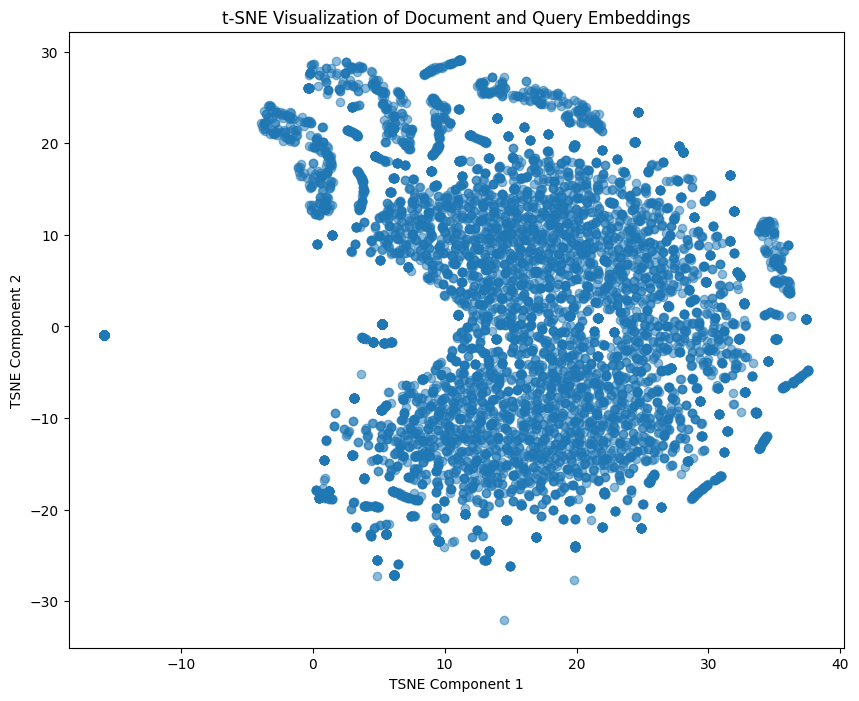

In [19]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA


cache_documents = torch.load('cache_documents.pt', map_location=device)

# Assuming 'all_embeddings' is a numpy array of all document and query embeddings
pca = PCA(n_components=50)  # Reduce to 50 dimensions for better t-SNE performance

emb = cache_documents.cpu().squeeze(1) 
print(emb.shape)
reduced_embeddings = pca.fit_transform(emb[:50000])

tsne = TSNE(n_components=2, perplexity=30, n_iter=300)
tsne_results = tsne.fit_transform(reduced_embeddings)

plt.figure(figsize=(10, 8))
plt.scatter(tsne_results[:, 0], tsne_results[:, 1], alpha=0.5)
plt.title('t-SNE Visualization of Document and Query Embeddings')
plt.xlabel('TSNE Component 1')
plt.ylabel('TSNE Component 2')
plt.show()


In [26]:
from bokeh.plotting import figure, show, output_notebook
from bokeh.models import HoverTool, ColumnDataSource

output_notebook()

source = ColumnDataSource(data=dict(
    x=tsne_results[:, 0],
    y=tsne_results[:, 1],
    desc=unique_documents[:50000],
))

p = figure(title='t-SNE Visualization of Document and Query Embeddings',
           tools="pan,wheel_zoom,box_zoom,reset,hover,save")

p.circle('x', 'y', size=5, source=source)
hover = p.select(dict(type=HoverTool))
hover.tooltips = [("Document", "@desc")]
p.xaxis.axis_label = 'TSNE Component 1'
p.yaxis.axis_label = 'TSNE Component 2'

show(p)


Loading BokehJS ...

## Our own RNN

The RNN Cell

In [ ]:
class RNNCell(nn.Module):
    def __init__(self, input_size, hidden_size):
        super(RNNCell, self).__init__()
        self.input_size = input_size
        self.hidden_size = hidden_size
        
        # Initialize weights
        self.W_ih = nn.Parameter(torch.randn(input_size, hidden_size))
        self.W_hh = nn.Parameter(torch.randn(hidden_size, hidden_size))
        self.b_ih = nn.Parameter(torch.randn(hidden_size))
        self.b_hh = nn.Parameter(torch.randn(hidden_size))
    
    def forward(self, x, hidden):
        # Compute the next hidden state
        hidden_next = torch.tanh(x @ self.W_ih + self.b_ih + hidden @ self.W_hh + self.b_hh) # @ represents matrix multiplication in the last two dimensions
        return hidden_next

The RNN

In [ ]:
class RNN(nn.Module):
    def __init__(self, input_size, hidden_size):
        super(RNN, self).__init__()
        self.RNNCell = RNNCell(input_size, hidden_size)

    def forward(self, sequence, initial_hidden):
        hidden = initial_hidden
        for item in sequence:
            hidden = self.RNNCell(item, initial_hidden)
        return hidden